In [2]:
import os 
import keras
import numpy as np 
from tqdm import tqdm 
import tensorflow as tf

import pandas as  pd
# Data 
import scipy.ndimage as mp
from glob import glob
import pathlib
import cv2 as cv
from keras.preprocessing.image import img_to_array, load_img
from tensorflow.image import resize
import tensorflow.image as tfi


# Data visualization
import matplotlib.pyplot as plt


from PIL import Image

import subprocess
from IPython.display import FileLink, display

from keras.utils import  Sequence


In [3]:
#ссылоки на изображения и маски
images = sorted(glob(r'../input/aisegmentcom-matting-human-datasets/clip_img/*/*/*'))
masks = sorted(glob(r'../input/aisegmentcom-matting-human-datasets/matting/*/*/*'))

******** 


In [4]:
def see_pict(image, mask):
    plt.figure(figsize=(9, 5))
    plt.subplot(1,2,1)
    im = plt.imread(image)
    plt.imshow(im)
    plt.subplot(1,2,2)
    label = load_img(mask)
    label = img_to_array(label)[:,:,0]
    label = label != 0
    label = tf.cast(label/255.0, tf.float64)
    plt.imshow(label)
    plt.show()

In [37]:

def distribution_mask_on_img(masks):
    mask_to_img_relation_list = []
    for m in masks:
        label = load_img(m)
        label = img_to_array(label)[:,:,0]
        label = np.where(label > 0, 1, 0)
        m_sum = np.sum(label) 
        mask_to_img_relation = m_sum/(label.shape[0]*label.shape[1])
        mask_to_img_relation_list.append(mask_to_img_relation)
    return mask_to_img_relation_list

 27241  22992 8359  

[ 6180 27241 24022 33853 17428]


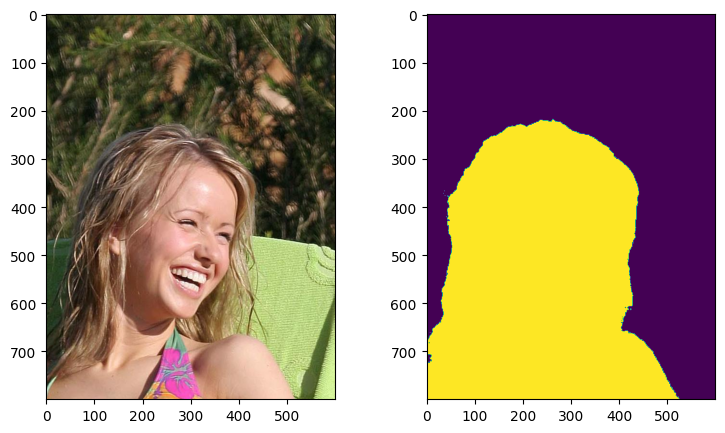

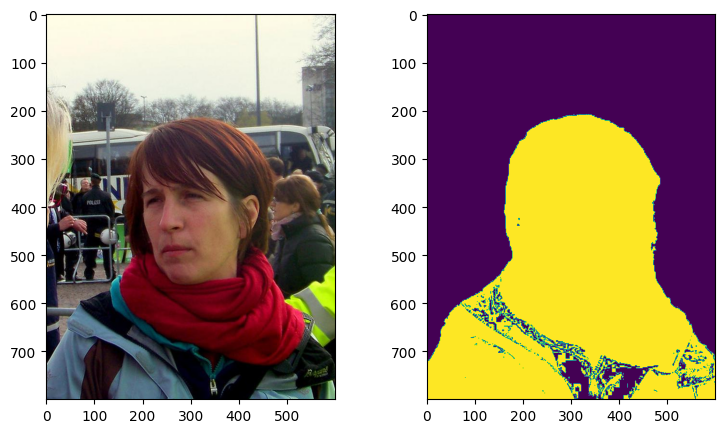

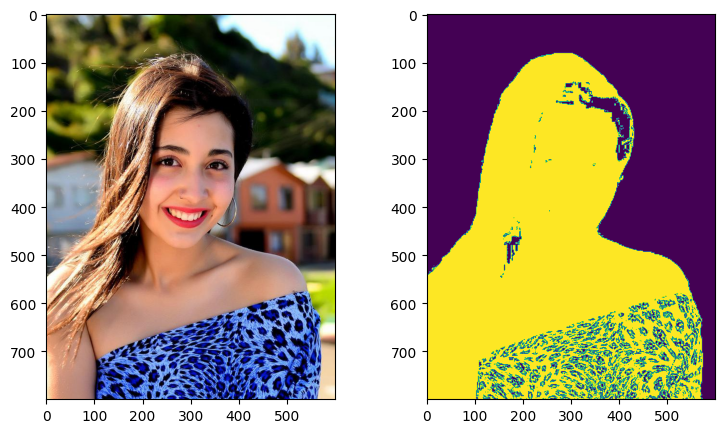

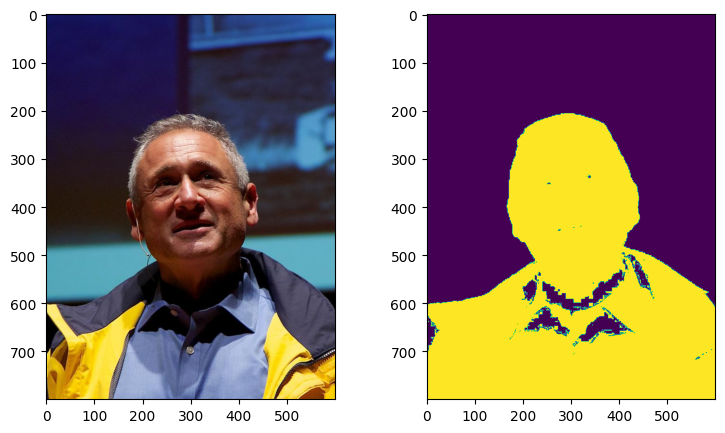

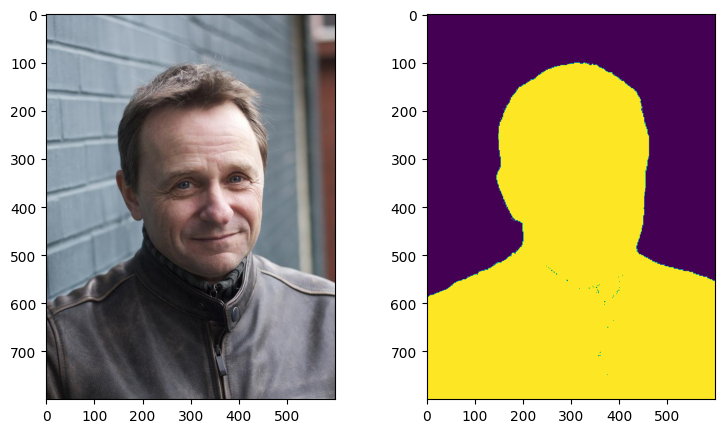

In [17]:
index = np.random.choice(range(len(images)), 5)
list_of_img = [images[i] for i in index]
list_of_mask = [masks[i] for i in index]
print(index)
for image, mask in zip(list_of_img, list_of_mask):
    see_pict(image, mask)

## BG problem

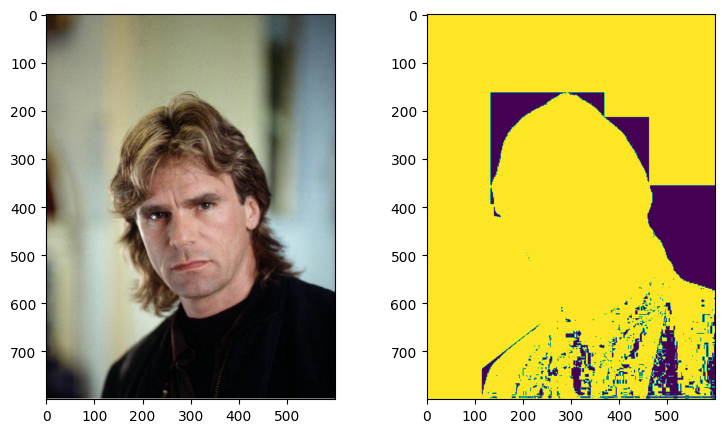

In [20]:
see_pict(images[87], masks[87])

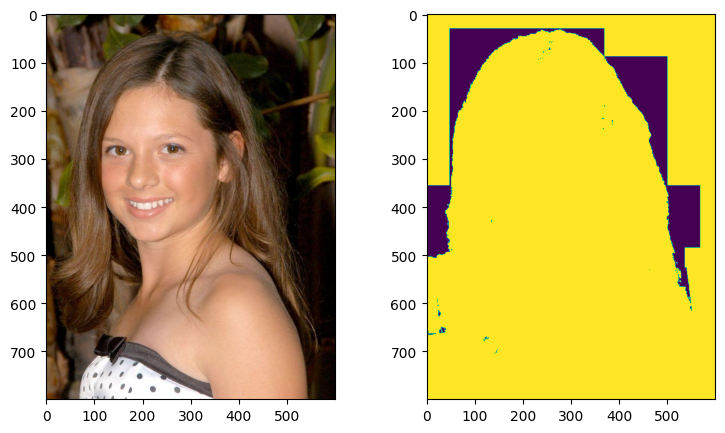

In [26]:
 see_pict(images[0], masks[0])

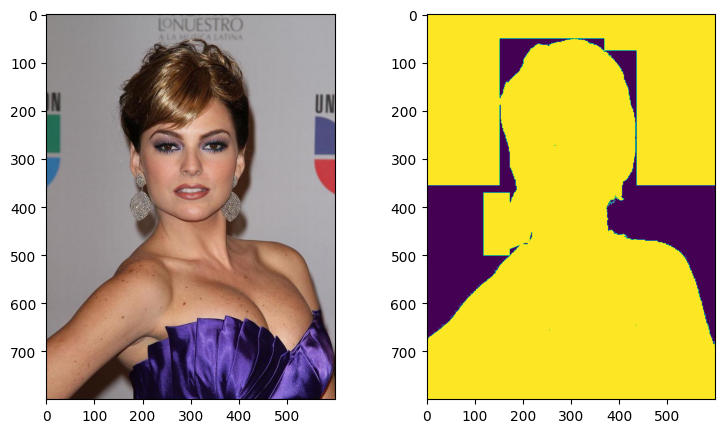

In [29]:
see_pict(images[27], masks[27])

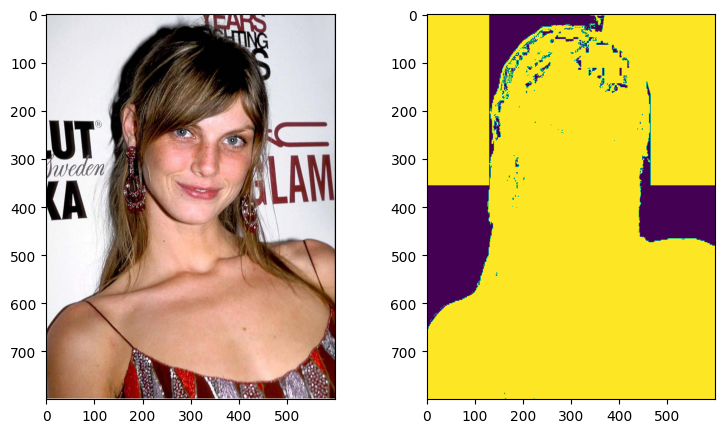

In [30]:
 see_pict(images[47], masks[47])

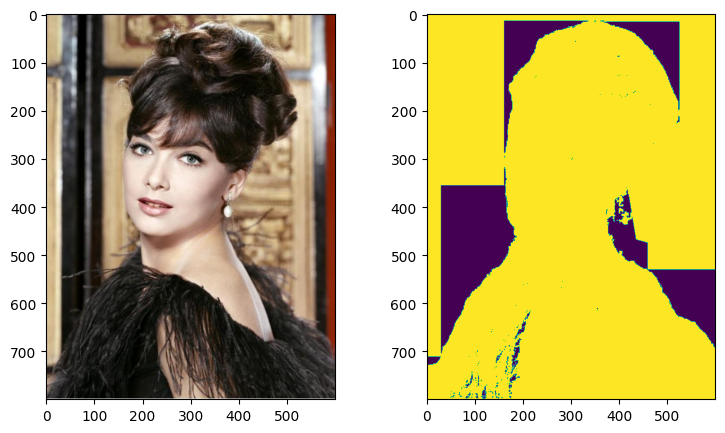

In [31]:
 see_pict(images[50], masks[50])

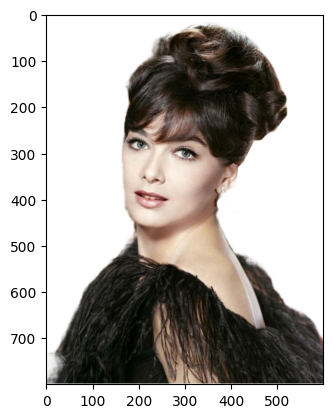

In [35]:
plt.imshow(plt.imread(masks[50]));

## Problem
Often when we create a mask from png image we have mask with holes. Also some mask have parts of background. The holes in the picture will be a big problem for educatiol process.  
First - For model it is harder to remember comprehansive mask with holes that the true mask.  
Second - Even if we have a good models on our train and test dataset it works bad on real data.   And our model will create hole in real picture so when we cut the image using mask we have this holes. It could make holes when peopel have deep black colour like eyse or hair.  
Below we try some trics to make a proper mask 


## Relation between mask size and image size

In [42]:
mask_to_img_relation_list = distribution_mask_on_img(masks)

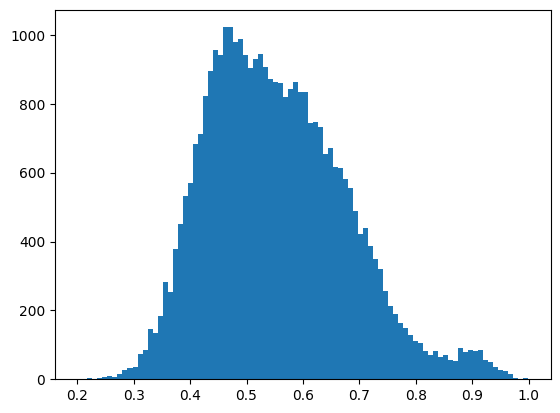

In [43]:
plt.hist(mask_to_img_relation_list, bins=90);

As we see on exapmle 87, 50, 47 when we convert png mask to (1,0) mask we recive a lot of BG. We gonna use the images and masks where mask take from 0.3 to 0.85 from image size

## Manipulations with mask

In [44]:
def masking_problem(img, mask, method=None, multiply=False, transform=None, brightness = 100, contrast=100):
    
    plt.figure(figsize=(19, 5))
    plt.subplot(1,4,1)
    im = plt.imread(img)
    plt.title("Image")
    plt.imshow(im)
    
    plt.subplot(1,4,2)
    m = plt.imread(mask)
    plt.imshow(m)
    plt.title("Matting")
    
    plt.subplot(1,4,3)
    ml = m!=0
    ml=ml[:,:,0]
    plt.title("Mask without manipulations")
    plt.imshow(ml)

    plt.subplot(1,4,4)
    if method != None:
        m = tf.image.resize(m,(im.shape[0], im.shape[1]), method=method)
        m = m[:,:,0]
    if multiply != False:
        m = 10e7*m[:,:,0] + 10e7*m[:,:,1] + 10e7*m[:,:,2]
    elif method != None and transform != None and multiply != False:
        m = m[:,:,0]
    if transform != None:
        m = transform(m, contrast=contrast, brightness=brightness)
        m = m[:,:,0]
    
    m = m!=0
    plt.title("Mask with manipulations")
    plt.imshow(m)
    
  


In [45]:
def brightnes_contrast(img, brightness = 100, contrast=100):
    img = np.int64(img)
    img = img * (contrast/127+1) - contrast + brightness
    img = np.clip(img, 0, 255)
    img = np.uint8(img)
    return img

## Summing filtrs from png

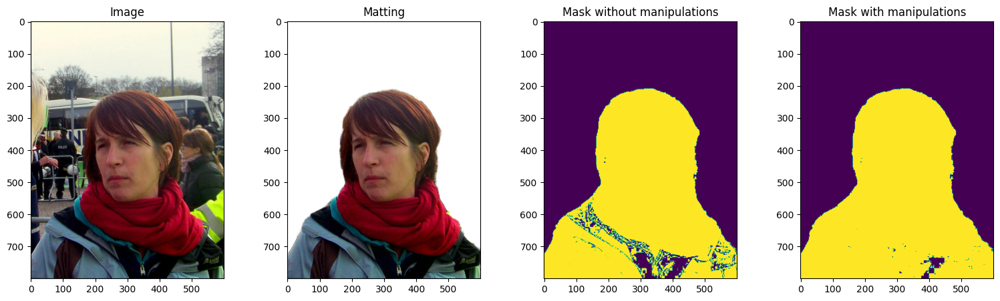

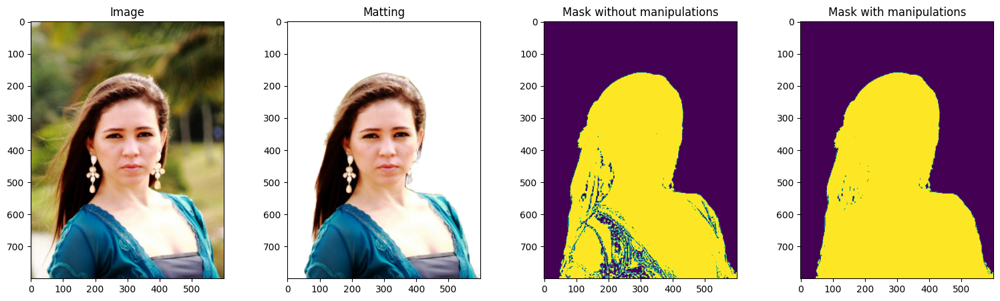

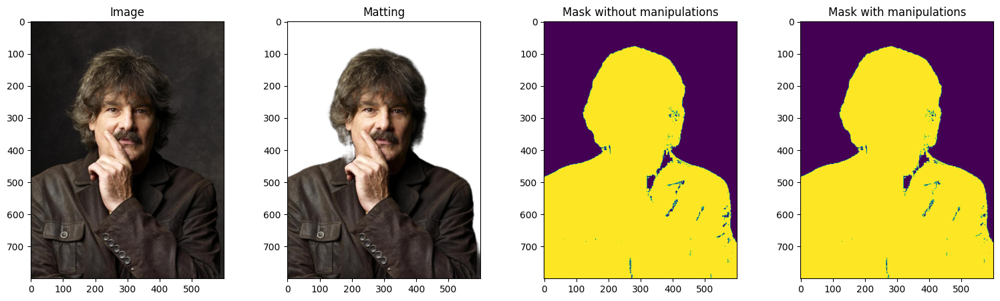

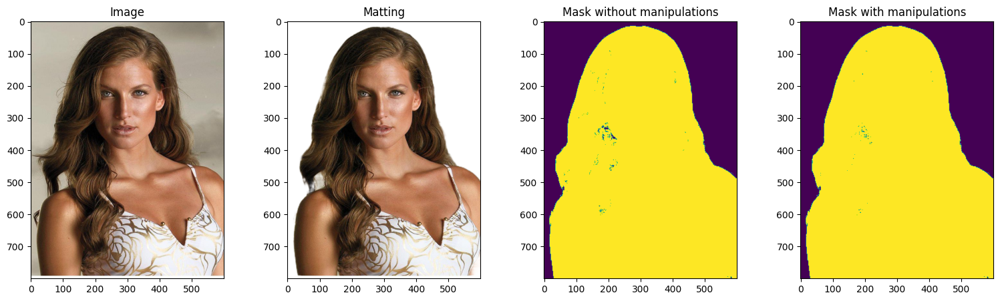

In [46]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=None, multiply=True, transform=None,)

## Brightnes and Conrast

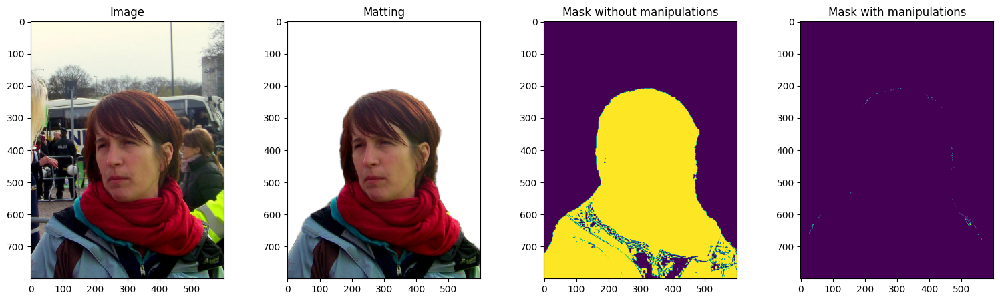

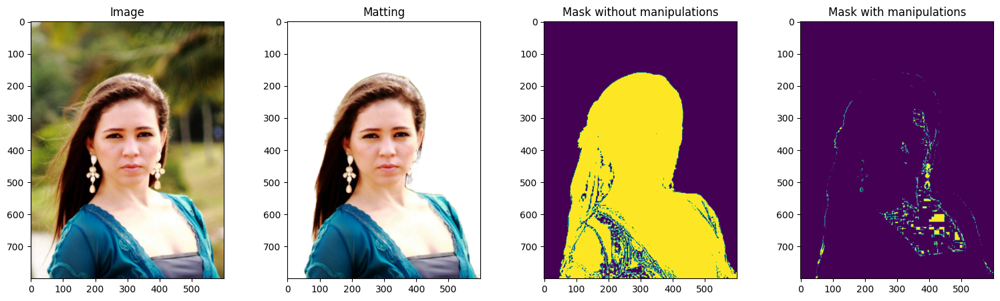

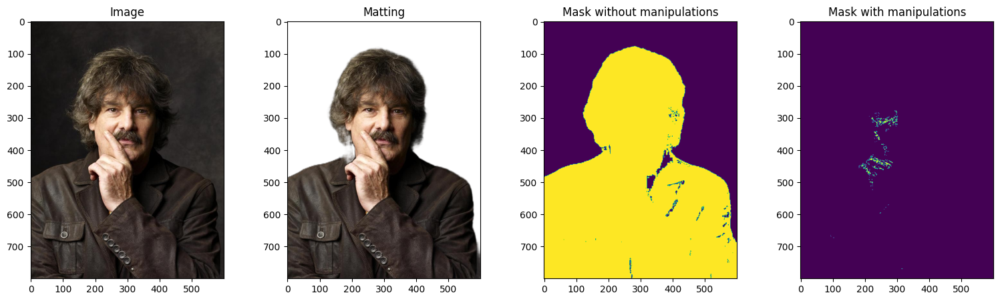

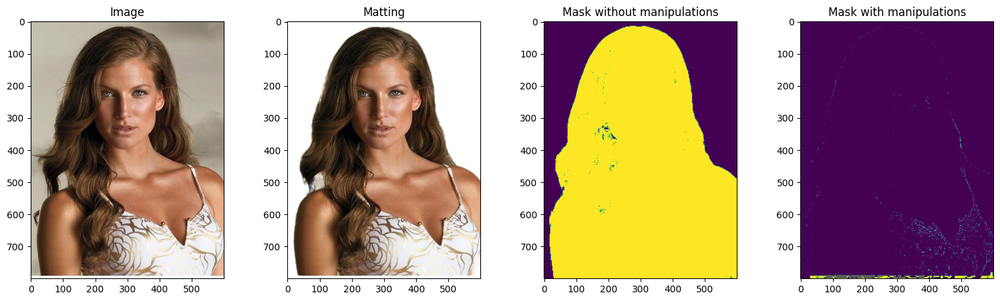

In [47]:
indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=None, multiply=False, transform=brightnes_contrast)

## Using ResizeMethod from Tensorflow

### LANCZOS5

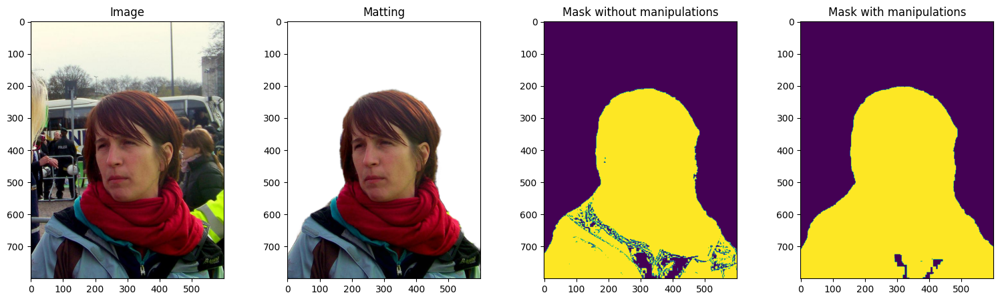

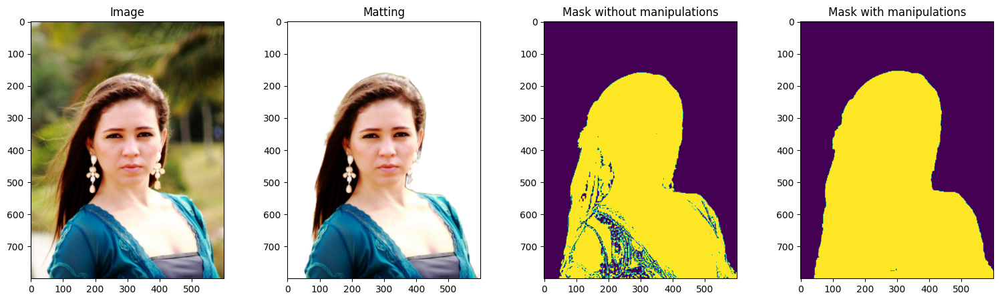

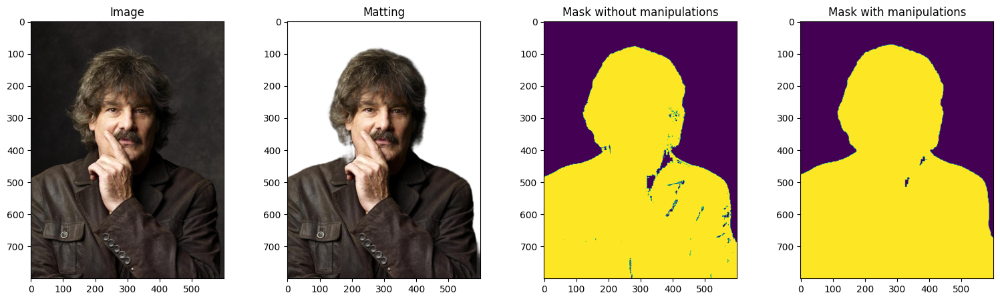

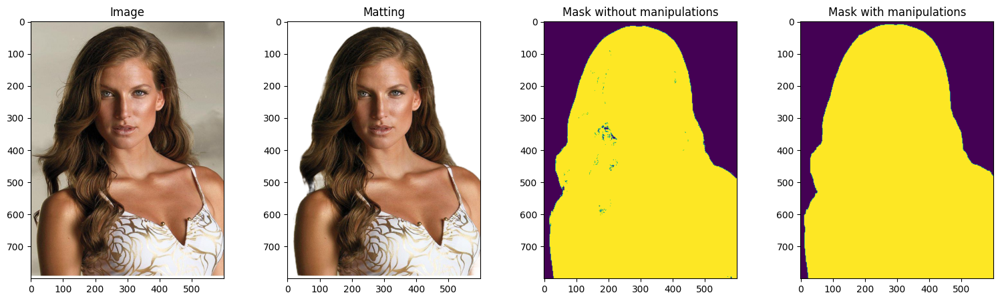

In [55]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.LANCZOS5, multiply=False, transform=None)

### LANCZOS3

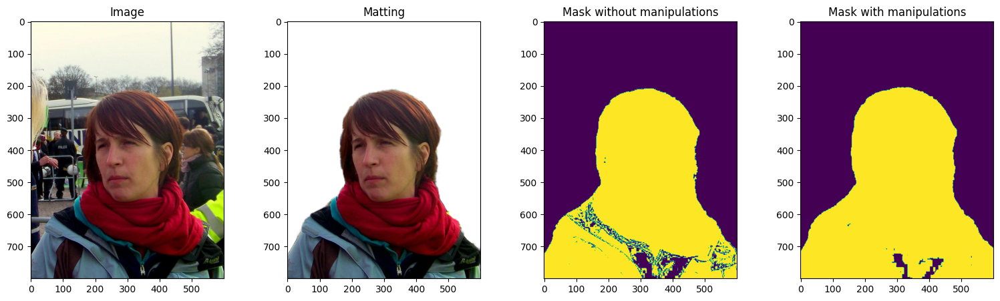

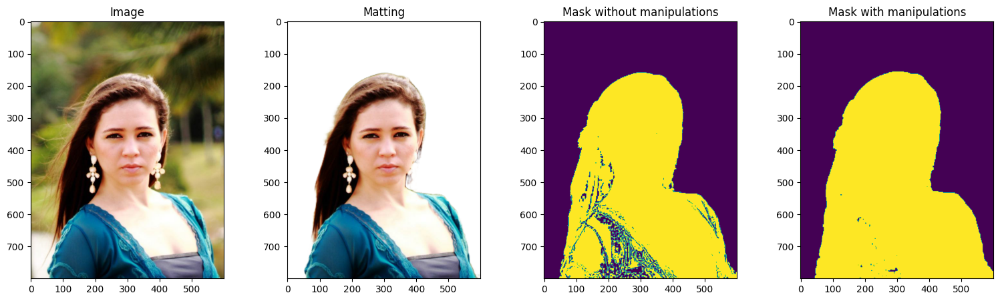

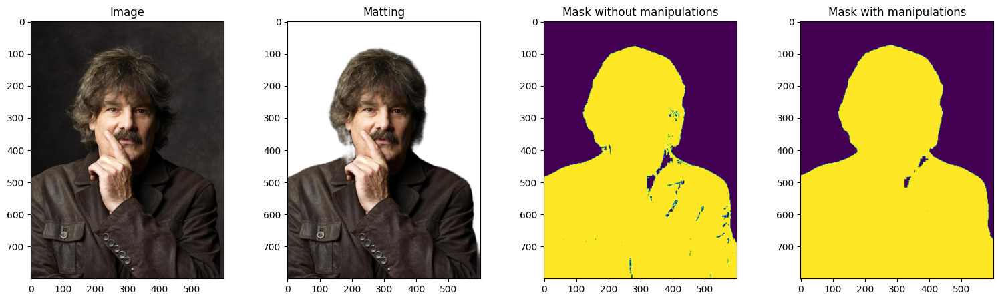

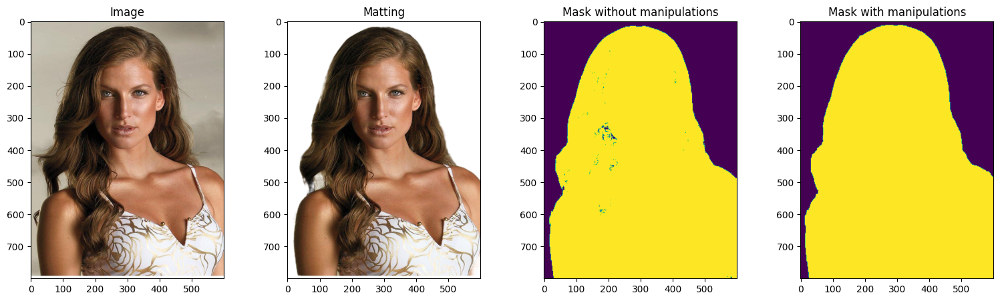

In [48]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.LANCZOS3, multiply=False, transform=None)

### NEAREST_NEIGHBOR

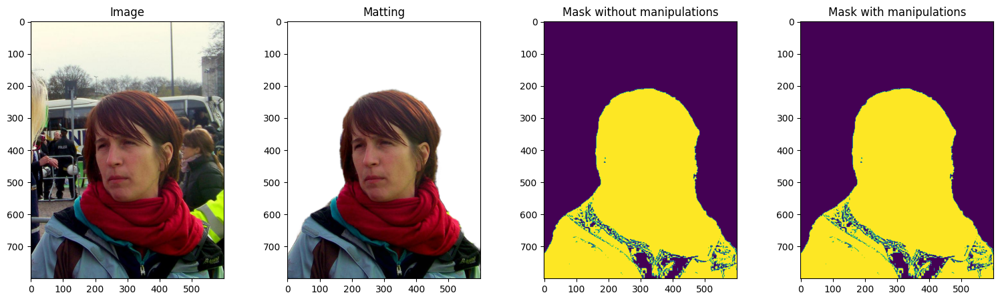

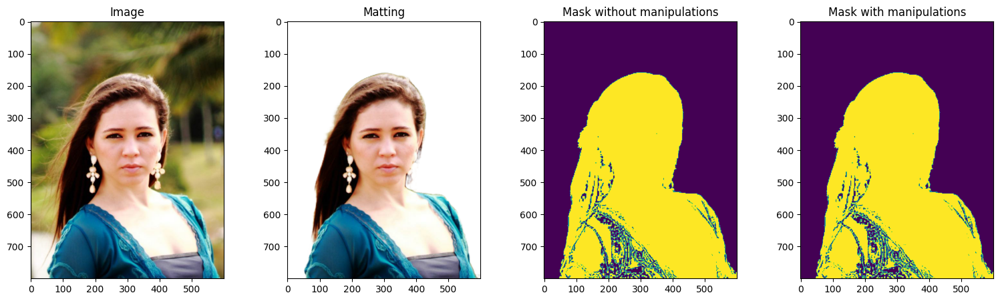

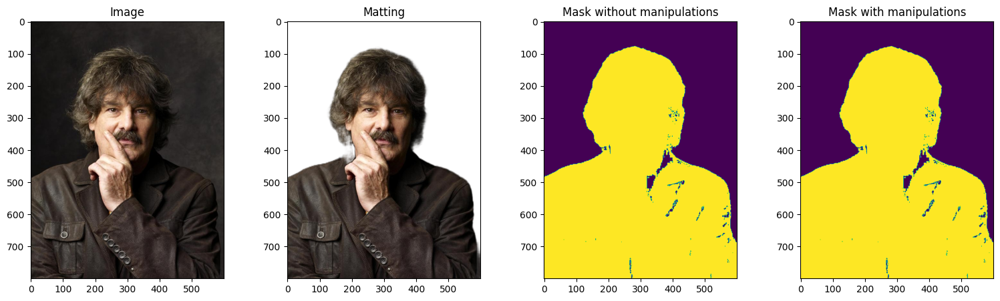

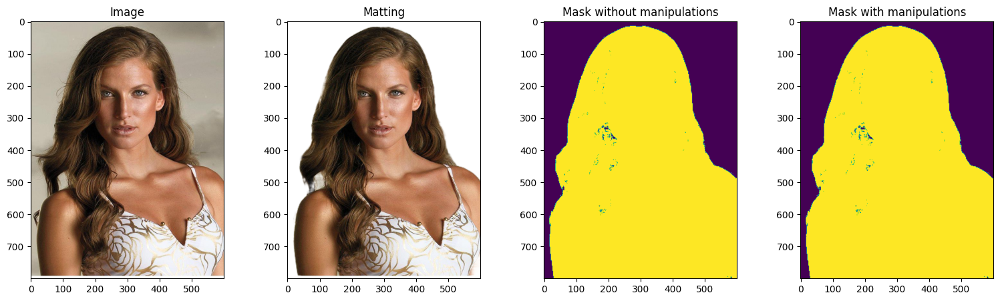

In [56]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR, multiply=False, transform=None)

### MITCHELLCUBIC

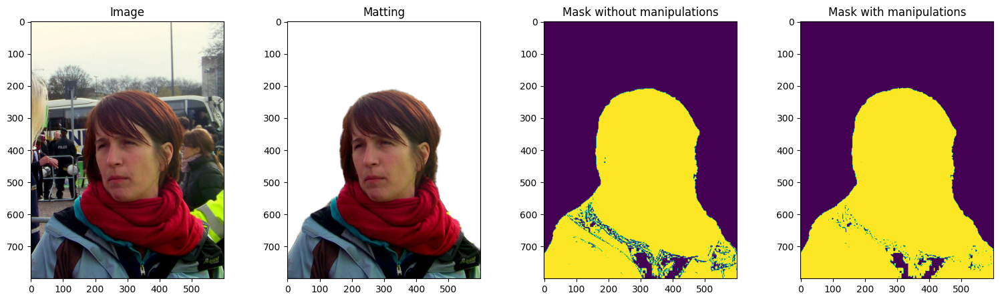

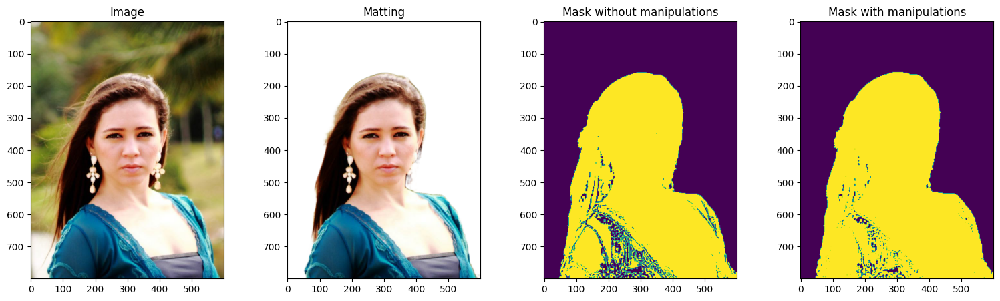

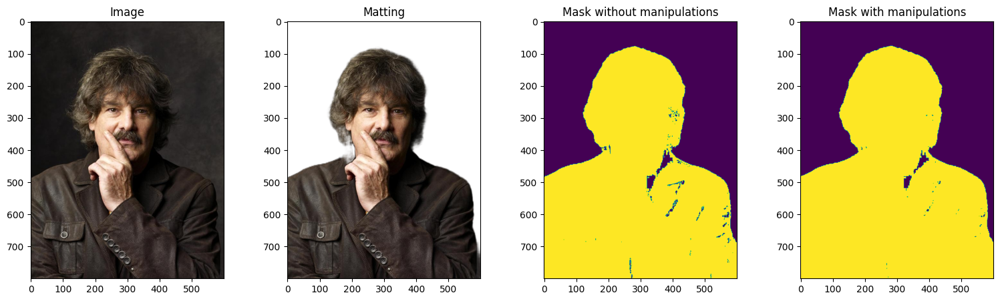

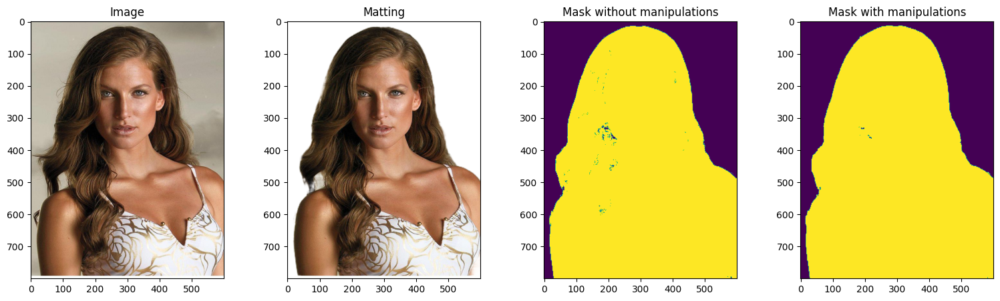

In [50]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.MITCHELLCUBIC, multiply=False, transform=None)

### GAUSSIAN

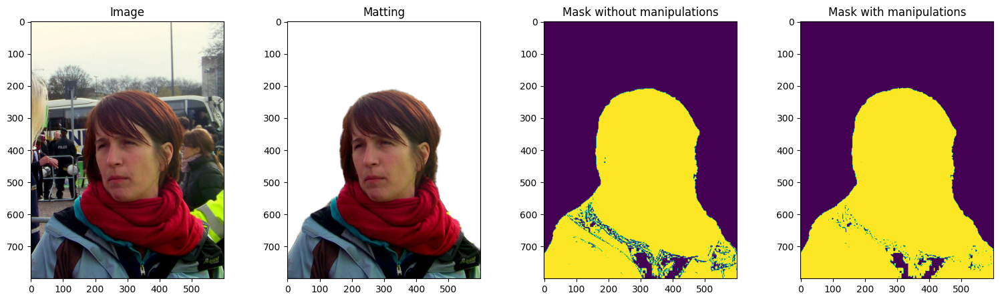

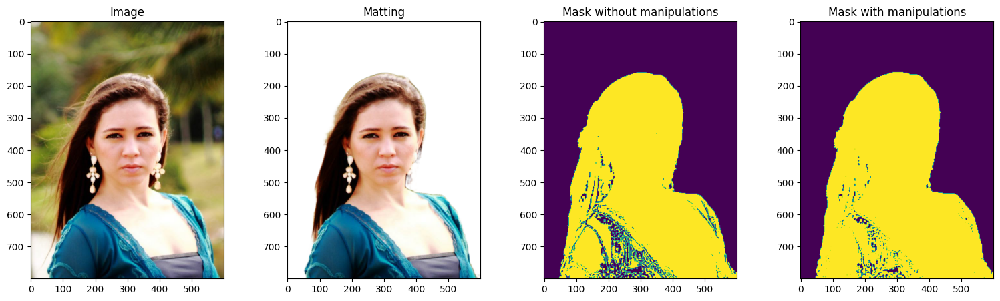

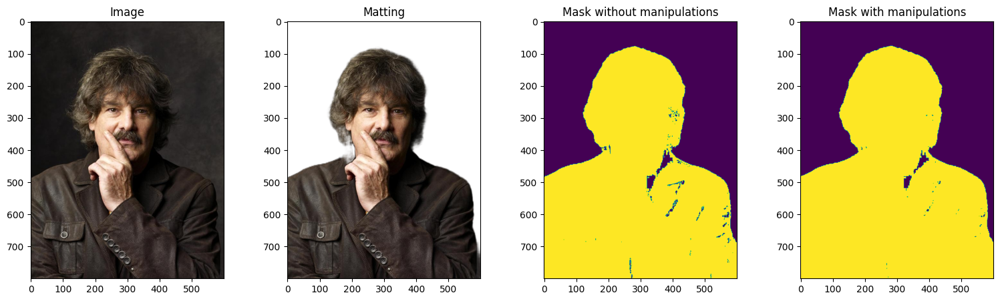

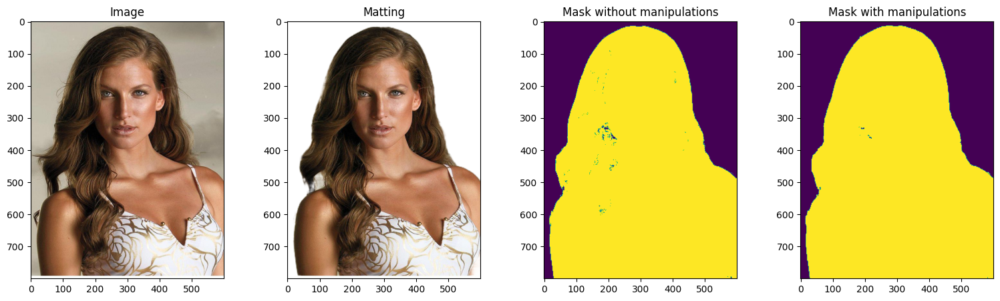

In [51]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.GAUSSIAN, multiply=False, transform=None)

### BILINEAR

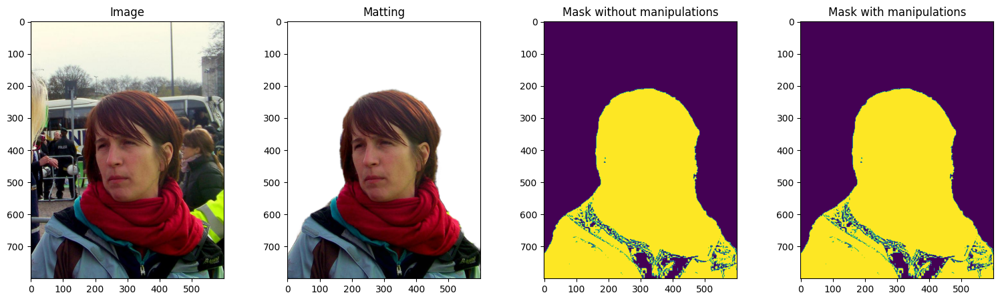

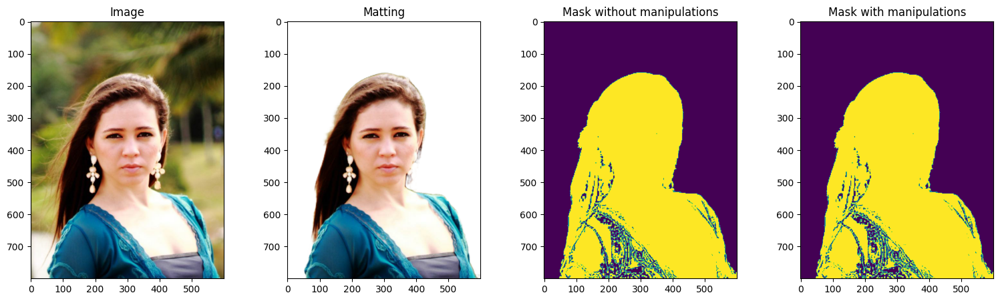

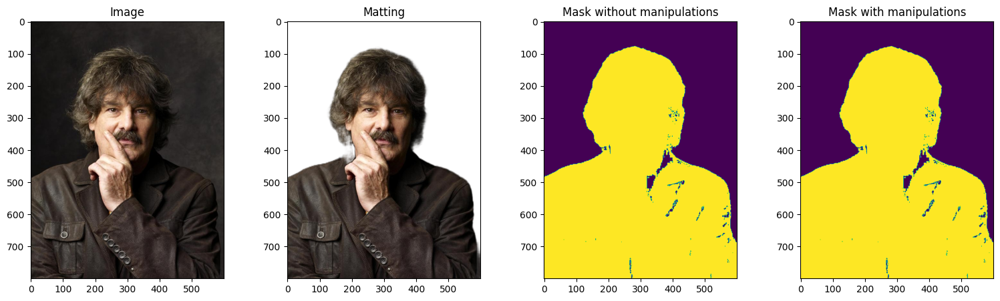

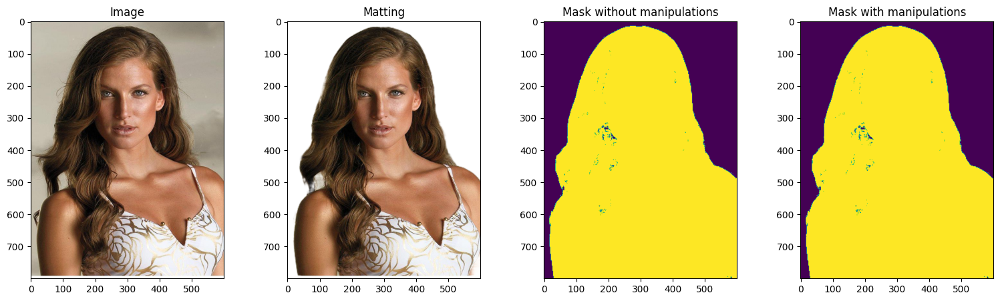

In [52]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.BILINEAR, multiply=False, transform=None)

### BICUBIC

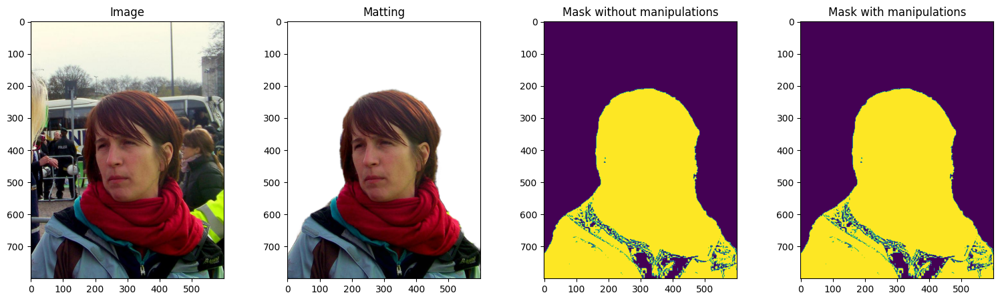

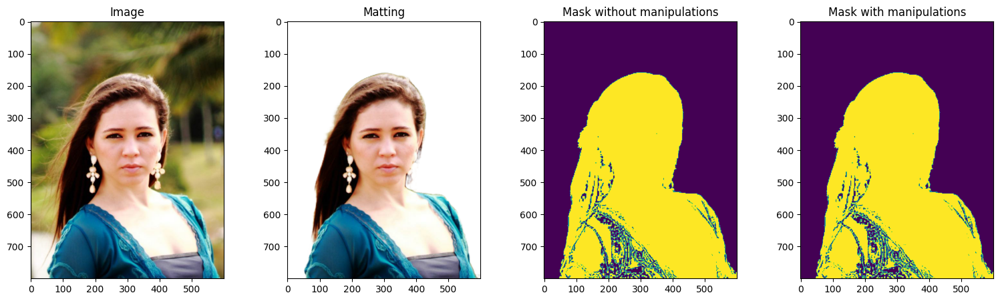

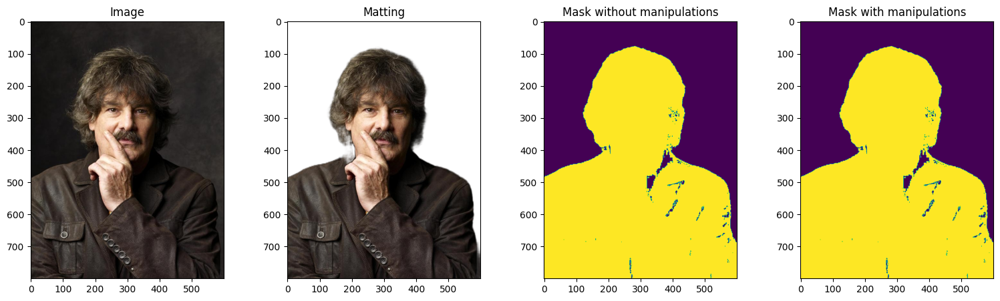

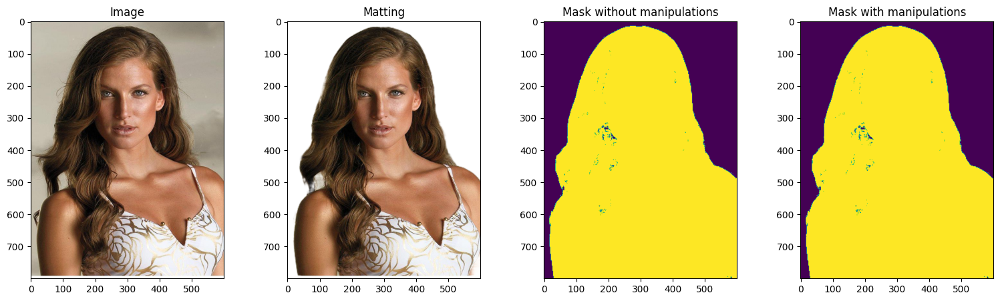

In [53]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.BICUBIC, multiply=False, transform=None)

### AREA

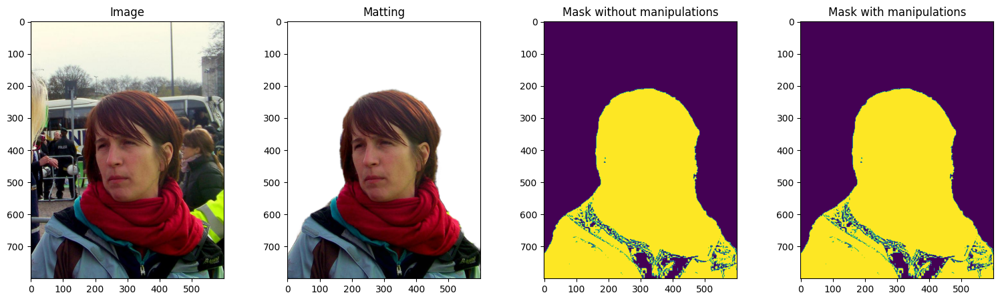

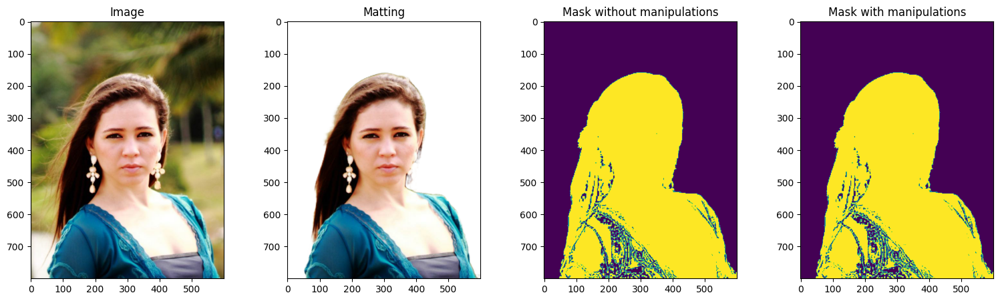

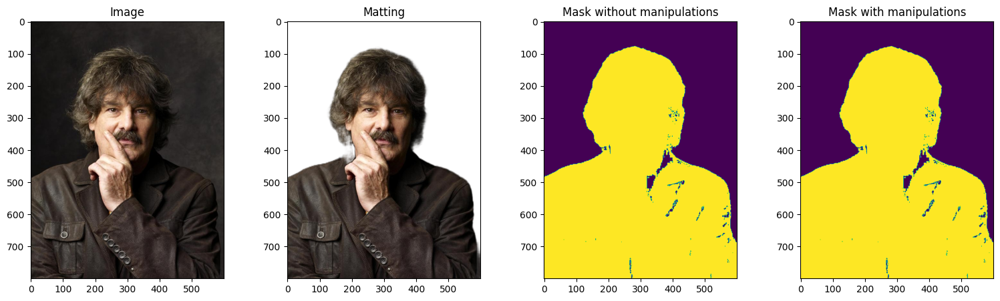

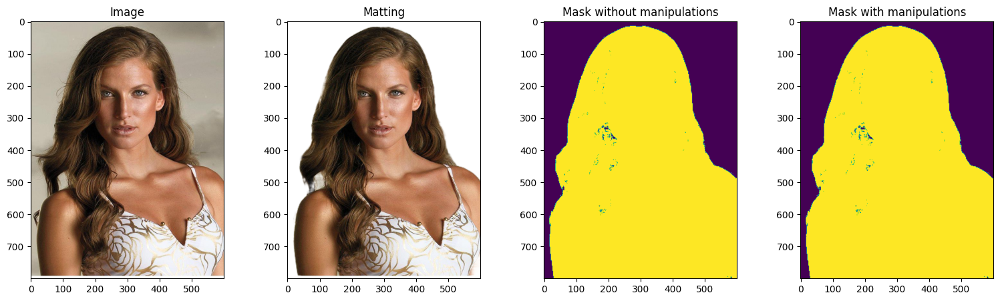

In [54]:

indexs = [ 27241, 22992, 8359, 76]
for i in indexs:
    masking_problem(images[i], masks[i], method=tf.image.ResizeMethod.AREA, multiply=False, transform=None)

## Using Scaning Vector String 

See for picture vector by vector (string) and fill with ones vector from first number to the last number if this number is not 0

In [57]:
def matting_solution(img, mask):
    # единственная проблема что не оч быстро работает
    # надо попробовать работать сразу со всей матрицей а не вектор строкой
        
    m = plt.imread(mask)
    m = m[:,:,0]
    m = (m[:,:]>0).astype(np.float16)
    
    for i, vector in enumerate(m):
        Z = np.zeros_like(vector)
        O = np.ones_like(vector)
        one_indexs = []
        
        for i2, el in enumerate(vector):
            if el > 0:
                one_indexs.append(i2)
        if one_indexs:
            Z[one_indexs[0]:one_indexs[-1]] = O[one_indexs[0]:one_indexs[-1]]
            m[i,:] = Z
            
            
    plt.figure(figsize=(15,5))
    plt.subplot(1, 3, 1)
    image = cv.imread(img, cv.COLOR_BGR2RGB)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    plt.title("Images")
    plt.imshow(image)
        
    plt.subplot(1, 3, 2)
    plt.title("Mask")
    mask = cv.imread(mask)
    mask = (mask[:,:,0]>0).astype(np.float32) #mask = np.where(mask > 0, 1, mask)
    plt.imshow(mask)
        
    plt.subplot(1, 3, 3)
    
    plt.title("Mask with manipulation")
    plt.imshow(m);
       

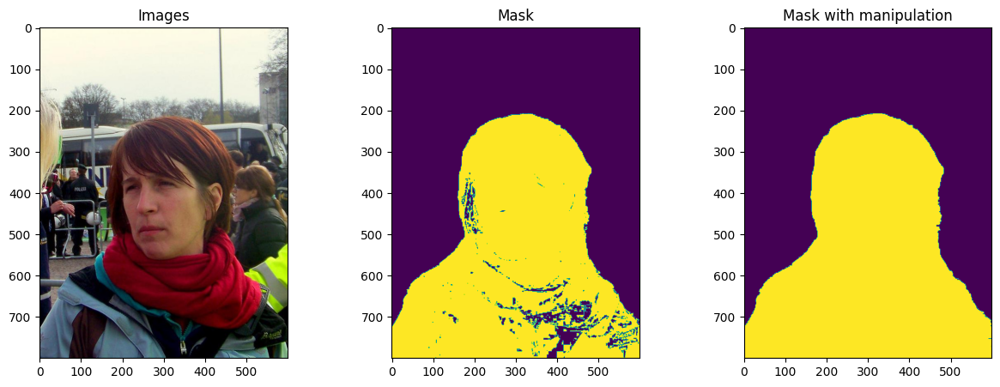

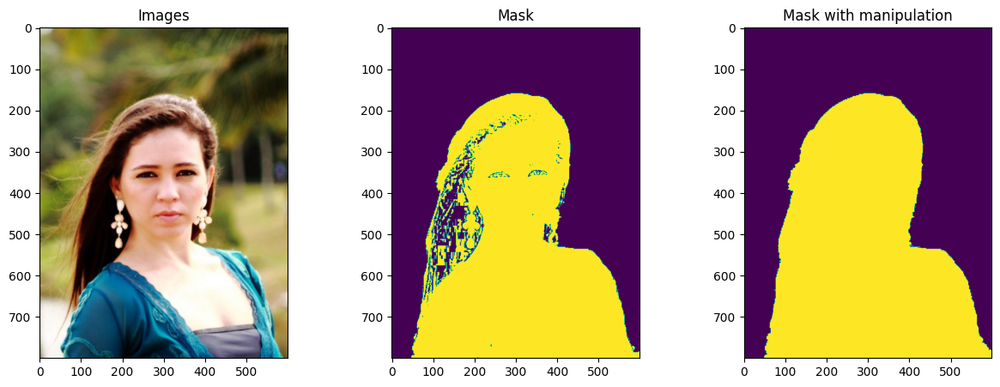

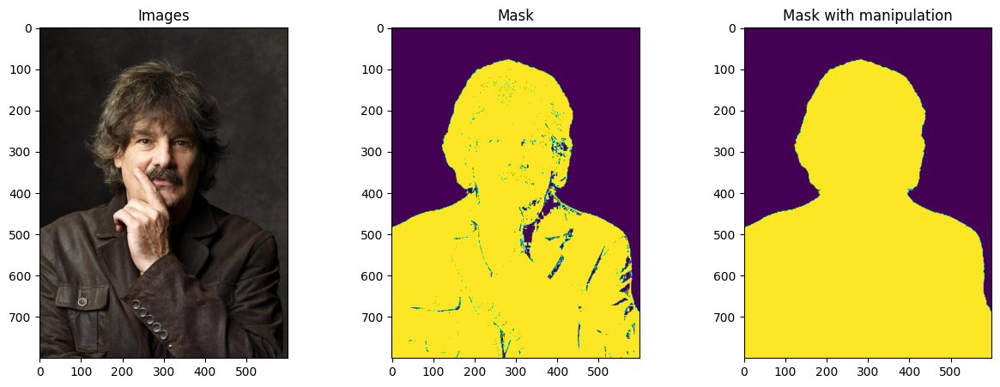

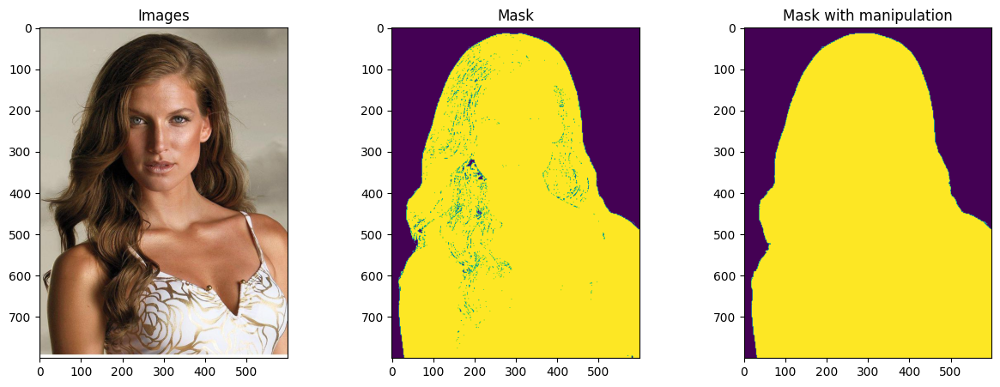

In [61]:
indexs = [ 27241, 22992, 8359, 76]
list_of_img = [images[i] for i in indexs]
list_of_mask =  [masks[i] for i in indexs]
for image, mask in zip(list_of_img, list_of_mask):
    matting_solution(image, mask)

## Matrics Scaning 
Using matrics for 

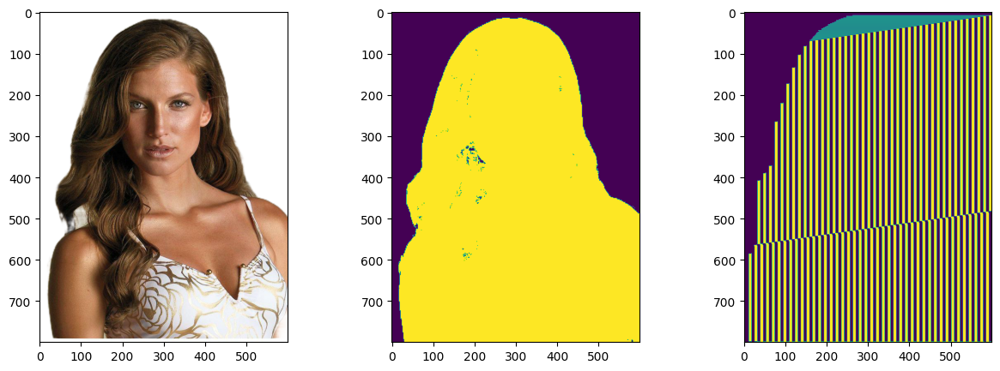

In [125]:
def matting_solution_matrix_trics(mask, size=9, step=4):
    plt.figure(figsize=(15,5))
    plt.subplot(1, 3, 1)
    M = plt.imread(mask)
    plt.imshow(M)
    M = M[:,:,0]
    M = (M[:,:]>0).astype(np.float16)
    plt.subplot(1,3,2)
    plt.imshow(M)
    i = 0
    j = 0
    half = M.shape[1]/2
    Z = np.zeros(size)
    O = np.ones(size)

    for i in range(M.shape[0]-size):
        # лок на строки
        n = i+size
        for j in range(M.shape[1]-size):
        
    #while i < M.shape[0]-size and j <  M.shape[1]-size: #по диагонали идет
            try:
                M_ = M[i: n, j: j+size]
                J = M[i: n, j+size] #vector 
                M_sum = np.sum(M_)
                J_sum = np.sum(J)
                if J_sum > 4:
                    M[i: n, j: j+size]= Z
                elif M_sum > 0 and J_sum <= 1:
                    M[i: n, j: j+size] = O
                #i, j = i + step, j+step
                #print(M_sum, J_sum)
            except (IndexError, ValueError):
                pass
            #print(M_sum, J_sum)
    
  

    plt.subplot(1,3,3)
    plt.imshow(M)
    plt.show()

    
            

matting_solution_matrix_trics(masks[76], size=7, step=3)

In [ ]:
def preprocess_del(images, masks):
    for im, ma in zip(images, masks):
        mask = load_img(ma)
        mask= img_to_array(ma)[:,:,0]
        massk = np.where(ma > 0, 1, 0)
        m_sum = np.sum(ma) 
        mask_to_img_relation = m_sum/(label.shape[0]*label.shape[1])
        if mask_to_img_relation >= 0.85 or mask_to_img_relation <= 0.25:
            masks.pop(ma)
            images.pop(im)
            
            
        

In [ ]:

import os # Модуль для работы с OC
import shutil # Модуль для копирования файлов

def copy_files(folder1, folder2, extensions=()): # Создаём функцию. Получаем 1 и 2 папки; расширение, если требуется

    for file in os.listdir(folder1): #Получаем список файлов в 1 папке и их названия, как file
        if extensions: # Если расширения указаны
            for extention in extentions: # Присваиваем extention значения extentions поочерёдно
                if '.' not in extencion: # Если в расширении нет точки
                    extention = f'.{extention}' # Добавляем точку на всякий случай
                if extention in file: # Если файл содержит это расширение
                    cont = True
                    break
                else:
                    cont = False
            if cont: # Если cont равен True
                shutil.copyfile(f'{folder1}/{file}', f'{folder2}/{file}')
        else:
            shutil.copyfile(f'{folder1}/{file}', f'{folder2}/{file}')

way1 = 'D:\ok\files' # 1 путь
way2 = 'C:\Users\romaz\Desktop\images' # 2 путь
copy_files(way1, way2, ('.png', '.jpg'))

In [ ]:
for ma in masks:
    ma = preprocess(ma)
    ma.save(Path+ma)
    in_path = ma[]
    out_path = PATH + ma 
    shutil.copyfile(path_s+file, path_d+file)

In [ ]:
import shutil
import os
path_s = r'D:/ok/files/'
path_d = r'C:/Users/romaz/Desktop/images/'
for file in os.listdir (path_s):
    if file.endswith(".png") or file.endswith(".jpg"):
        shutil.copyfile(path_s+file, path_d+file)

In [ ]:
def preprocess_transform_mkdir(, masks):
    PATH = '/kaggle/working/'
    for ma in zip(masks):
        ## открытие и преобразование маски 
        ## маску в нумпай записываем в новую директорию
        